In [ ]:
!apt-get update
!apt-get install -y libopencv-dev
!apt-get install -y libboost-all-dev
!git clone https://github.com/lava/matplotlib-cpp
!cd matplotlib-cpp && make

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:4 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:5 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:8 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,188 kB]
Get:9 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease [18.1 kB]
Get:10 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,625 kB]
Hit:11 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,513 kB]
Hit:13 https://ppa.launchp

Saving narto.jpg to narto.jpg
Gambar berhasil di-upload dan disimpan sebagai 'input.jpg'.


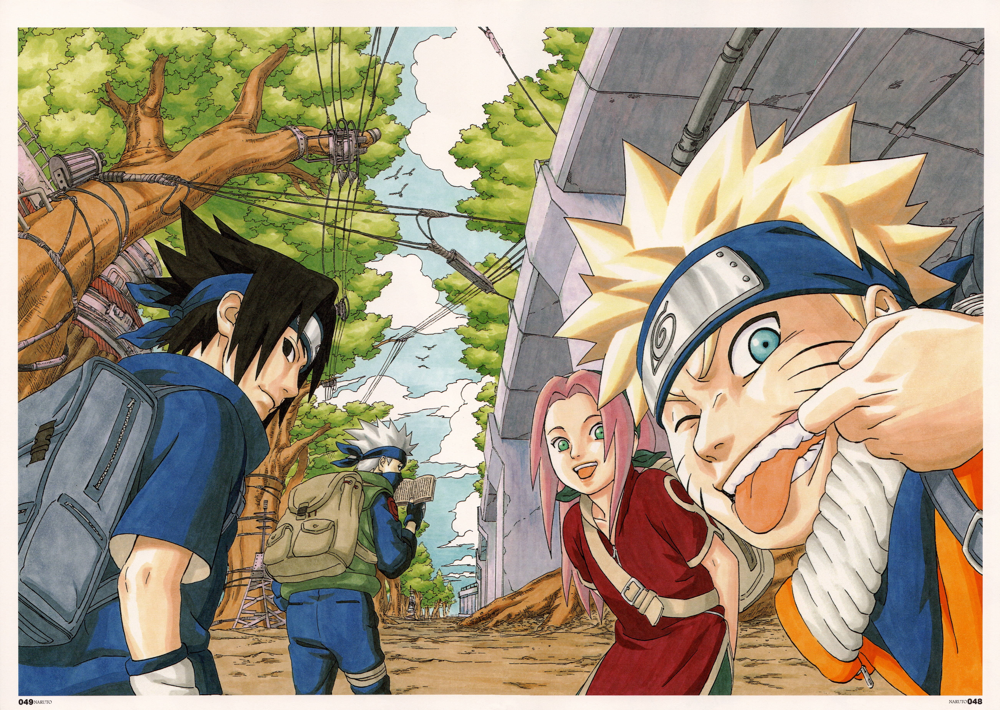

In [ ]:
from google.colab import files
import shutil
from IPython.display import Image, display

# Meminta pengguna untuk meng-upload gambar
uploaded = files.upload()

# Mengambil nama file gambar yang di-upload
for filename in uploaded.keys():
    # Pindahkan gambar ke file yang diinginkan (misalnya input.jpg)
    shutil.move(filename, "input.jpg")

print("Gambar berhasil di-upload dan disimpan sebagai 'input.jpg'.")

# Menampilkan gambar
display(Image(filename="input.jpg"))

In [ ]:
%%writefile imagefilters.cu

#include <cuda_runtime.h>
#include <iostream>
#include <opencv2/opencv.hpp> // Pastikan OpenCV sudah terinstal
#include <chrono>

using namespace cv;
using namespace std;
using namespace chrono;

// Kernel untuk mengubah gambar menjadi grayscale
__global__ void convertToGrayscale(unsigned char* d_input, unsigned char* d_output, int width, int height, int channels) {
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;

    if (x < width && y < height) {
        int idx = (y * width + x) * channels;
        unsigned char r = d_input[idx];
        unsigned char g = d_input[idx + 1];
        unsigned char b = d_input[idx + 2];
        d_output[y * width + x] = 0.299f * r + 0.587f * g + 0.114f * b;
    }
}

// Kernel untuk mengubah gambar menjadi black and white
__global__ void convertToBlackAndWhite(unsigned char* d_input, unsigned char* d_output, int width, int height, int channels, unsigned char threshold) {
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;

    if (x < width && y < height) {
        int idx = (y * width + x) * channels;
        unsigned char r = d_input[idx];
        unsigned char g = d_input[idx + 1];
        unsigned char b = d_input[idx + 2];
        unsigned char gray = 0.299f * r + 0.587f * g + 0.114f * b;
        d_output[y * width + x] = (gray > threshold) ? 255 : 0;
    }
}

// Kernel untuk mengaplikasikan filter merah
__global__ void applyRedFilter(unsigned char* d_input, unsigned char* d_output, int width, int height, int channels) {
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;

    if (x < width && y < height) {
        int idx = (y * width + x) * channels;

        unsigned char b = d_input[idx];
        unsigned char g = d_input[idx + 1];
        unsigned char r = d_input[idx + 2];

        // Meningkatkan merah, mengurangi hijau dan biru
        unsigned char newB = max(0, b - 30);    // Kurangi biru
        unsigned char newG = max(0, g - 30);    // Kurangi hijau
        unsigned char newR = min(255, r + 30);  // Tingkatkan merah

        d_output[idx] = newB;
        d_output[idx + 1] = newG;
        d_output[idx + 2] = newR;
    }
}

// Kernel untuk mengaplikasikan filter biru
__global__ void applyBlueFilter(unsigned char* d_input, unsigned char* d_output, int width, int height, int channels) {
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;

    if (x < width && y < height) {
        int idx = (y * width + x) * channels;

        unsigned char b = d_input[idx];
        unsigned char g = d_input[idx + 1];
        unsigned char r = d_input[idx + 2];

        // Atur lebih halus
        unsigned char newB = min(255, b + 30);  // Tambah biru, jangan terlalu tinggi
        unsigned char newG = max(0, g - 30);    // Kurangi hijau lebih lembut
        unsigned char newR = max(0, r - 30);    // Kurangi merah lebih lembut

        d_output[idx] = newB;
        d_output[idx + 1] = newG;
        d_output[idx + 2] = newR;
    }
}

int main() {
    int choice;
    cout << "Pilih kernel yang akan dijalankan:" << endl;
    cout << "1: Grayscale" << endl;
    cout << "2: Black and White" << endl;
    cout << "3: Red Filter" << endl;
    cout << "4: Blue Filter" << endl;
    cout << "Masukkan pilihan Anda (1-4): ";
    cin >> choice;

    // Load gambar menggunakan OpenCV
    Mat img = imread("input.jpg");
    if (img.empty()) {
        cerr << "Error: Gambar tidak ditemukan!" << endl;
        return -1;
    }

    int width = img.cols;
    int height = img.rows;
    int channels = img.channels();

    // Output Mat dan ukuran memori untuk output
    Mat outputImg;
    size_t outputSize;

    if (choice == 1 || choice == 2) {
        outputImg = Mat(height, width, CV_8UC1); // Grayscale
        outputSize = width * height * sizeof(unsigned char);
    } else if (choice == 3 || choice == 4) {
        outputImg = Mat(height, width, CV_8UC3); // RGB
        outputSize = width * height * channels * sizeof(unsigned char);
    } else {
        cerr << "Pilihan tidak valid!" << endl;
        return -1;
    }

    // Alokasi memori di device
    unsigned char *d_input, *d_output;
    size_t imgSize = width * height * channels * sizeof(unsigned char);

    cudaMalloc((void**)&d_input, imgSize);
    cudaMalloc((void**)&d_output, outputSize);

    cudaMemcpy(d_input, img.data, imgSize, cudaMemcpyHostToDevice);

    // Tentukan ukuran grid dan block
    dim3 blockDim(16, 16);
    dim3 gridDim((width + blockDim.x - 1) / blockDim.x, (height + blockDim.y - 1) / blockDim.y);

    // Mulai pengukuran waktu
    auto start = high_resolution_clock::now();

    if (choice == 1) {
        convertToGrayscale<<<gridDim, blockDim>>>(d_input, d_output, width, height, channels);
    } else if (choice == 2) {
        unsigned char threshold = 128;
        convertToBlackAndWhite<<<gridDim, blockDim>>>(d_input, d_output, width, height, channels, threshold);
    } else if (choice == 3) {
        applyRedFilter<<<gridDim, blockDim>>>(d_input, d_output, width, height, channels);
    } else if (choice == 4) {
        applyBlueFilter<<<gridDim, blockDim>>>(d_input, d_output, width, height, channels);
    }

    // Sinkronisasi GPU untuk memastikan kernel selesai
    cudaDeviceSynchronize();

    // Akhiri pengukuran waktu
    auto stop = high_resolution_clock::now();
    auto duration = duration_cast<milliseconds>(stop - start);

    cout << "Waktu eksekusi kernel: " << duration.count() << " ms" << endl;

    // Salin hasil dari device ke host
    cudaMemcpy(outputImg.data, d_output, outputSize, cudaMemcpyDeviceToHost);

    // Simpan hasil
    imwrite("output_img.jpg", outputImg);
    cout << "Proses selesai. Gambar disimpan sebagai 'output_img.jpg'" << endl;

    // Bersihkan memori
    cudaFree(d_input);
    cudaFree(d_output);

    return 0;
}

Writing imagefilters.cu


In [ ]:
!nvcc -o imagefilters imagefilters.cu -I/usr/include/opencv4 -lopencv_core -lopencv_imgcodecs -lopencv_highgui -diag-suppress 611
!./imagefilters

Pilih kernel yang akan dijalankan:
1: Grayscale
2: Black and White
3: Red Filter
4: Blue Filter
Masukkan pilihan Anda (1-4): 3
Waktu eksekusi kernel: 113 ms
Proses selesai. Gambar disimpan sebagai 'output_img.jpg'


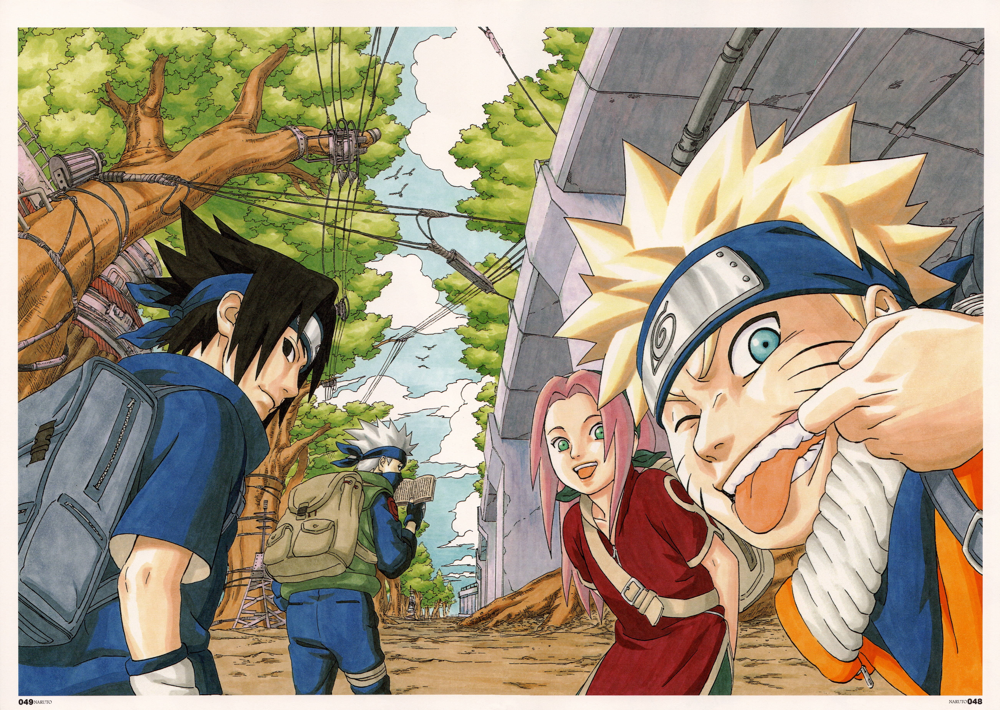

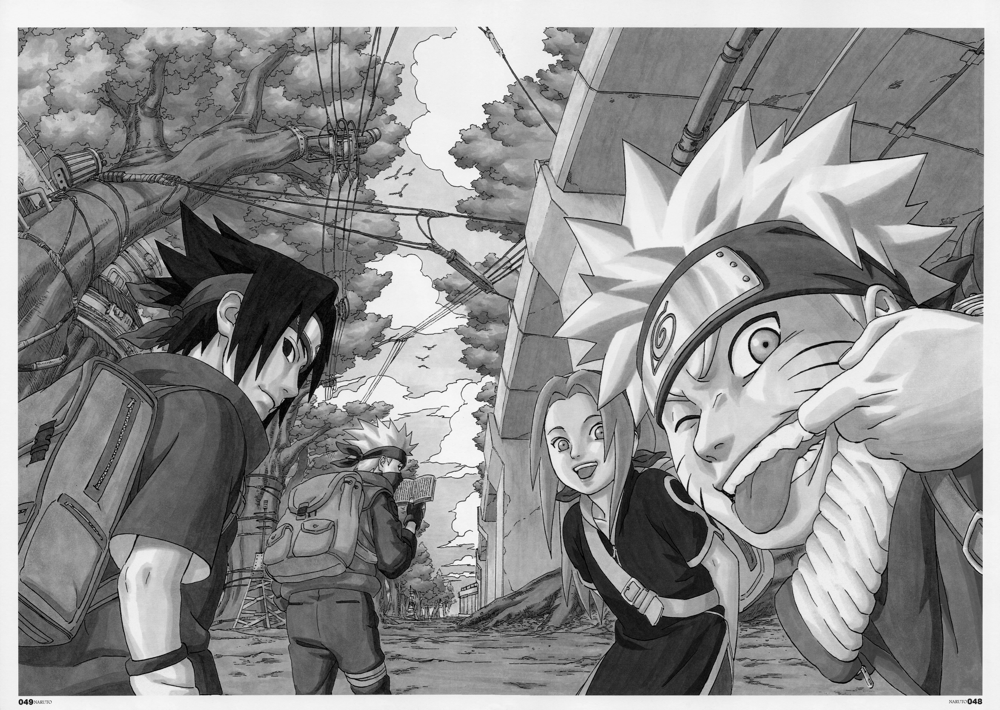

In [ ]:
from IPython.display import Image, display

display(Image("input.jpg"))
display(Image("output_img.jpg"))